In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import norm
import pyvinecopulib as pv
import seaborn as sns
from scipy import stats
from py_banshee.copula_test import cvm_statistic
from scipy.interpolate import interp1d
from py_banshee.rankcorr import bn_rankcorr
from py_banshee.bn_plot import bn_visualize
from py_banshee.d_cal import test_distance
from py_banshee.copula_test import cvm_statistic
from py_banshee.prediction import inference,conditional_margins_hist
import numpy as np
import pyvinecopulib as pv
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import multivariate_normal
import scipy.stats as stats
import matplotlib.cm as cm
import numpy as np
import pyvinecopulib as pv
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import multivariate_normal
import scipy.stats as stats
import matplotlib.cm as cm

%matplotlib inline 

In [2]:
# Compute ECDF
def empirical_cdf(data):
    sorted_data = np.sort(data)
    cdf = np.linspace(1 / len(sorted_data), 1, len(sorted_data))
    return dict(zip(sorted_data, cdf))

# Function to transform data columns to unit space using ECDF
def transform_to_unit_space(df, columns):
    for column in columns:
        # Calculate ECDF
        cdf = empirical_cdf(df[column])
        
        # Map each value in the column to its corresponding ECDF value (between 0 and 1)
        df[column] = df[column].map(cdf)
        
    return df

# Function to apply PPF to transform to normal distribution
def apply_ppf(df, columns):
    for column in columns:
        # Apply the PPF to transform to standard normal distribution
        df[column] = norm.ppf(df[column])
    return df

def unity(data):
    M = data.shape[0]  # Reading number of observations per node
    ranks = data.rank(axis=0)
    u_hat = ranks / (M + 1)
    return u_hat

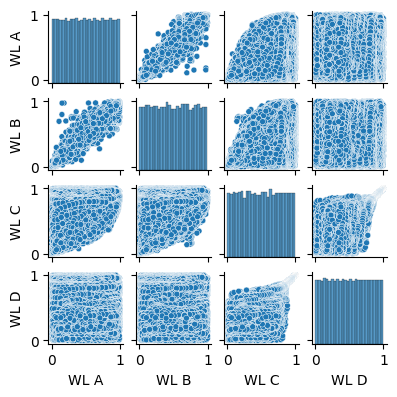

In [3]:
filepath = r"../Data/Clean/Obs_WL_All_Points.csv"
data = pd.read_csv(filepath, index_col=None)
data = data[(data['Datetime'] >= '2020-01-01') & (data['Datetime'] < '2022-01-01')]
data = data.drop(columns=['Datetime'])
unity_data = unity(data) 
sns.pairplot(unity_data, height=1,plot_kws=dict(size=.1))
plt.show()

In [4]:
# filepath = r"../Data/Clean/Obs_WL_All_Points.csv"
# data = pd.read_csv(filepath, index_col=None)
# data = data.drop(columns=['Datetime'])
# unity_data = unity(data) 
# sns.pairplot(unity_data, height=1,plot_kws=dict(size=.1))
# plt.show()

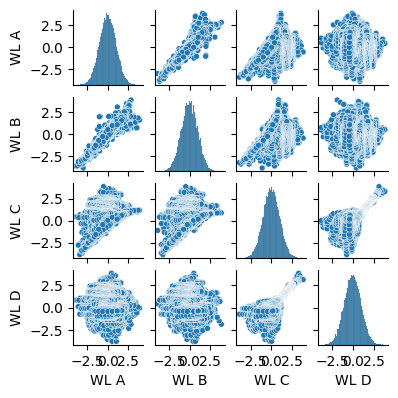

In [5]:
def sd_normal(data):
    M = data.shape[0]  # Reading number of observations per node
    ranks = data.rank(axis=0)
    u_hat = ranks / (M + 1)
    sd_data = stats.norm.ppf(u_hat)
    return sd_data

sd_data = pd.DataFrame(sd_normal(data), columns = data.columns)
sns.pairplot(sd_data, height=1,plot_kws=dict(size=.1))
plt.show()

In [6]:
# import warnings  
# warnings.filterwarnings("ignore")

# M = cvm_statistic(data, plot=1, names=data.columns,fig_name='CvM')

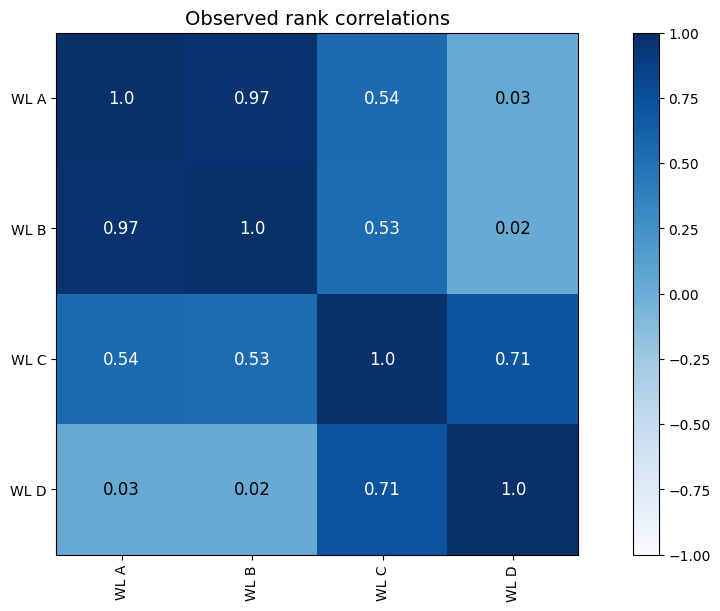

In [7]:
#Calculate the rank correlation matrix
R_e = stats.spearmanr(data)[0]

#Plot
nam = data.columns
px = list(range(len(nam)))

fig, axes = plt.subplots(1,1, figsize=(15,6), layout='constrained')
im1=axes.imshow(R_e, cmap='Blues', vmin=-1, vmax=1)
axes.set_xticks(px, nam, rotation=90)
axes.set_yticks(px, nam)
axes.set_title('Observed rank correlations',fontsize=14)
zz2 = np.round(R_e, 2)
zz = zz2.astype(str)
for i in range(len(nam)):
    for j in range(len(nam)):
        if zz2[i,j]>0.5:
            color = 'w'
        else:
            color = 'k'
        axes.text(j, i, zz[i, j],
                        ha="center", va="center",
                        fontsize=12, color=color)
cbar = fig.colorbar(im1,ax=axes, fraction=0.05, pad=0.04)
plt.show()

In [8]:
#Fit using Dissman's
vine_model = pv.Vinecop.from_data(np.array(unity_data))

#Let's see how the structure looks
vine_model.matrix

array([[1, 3, 4, 4],
       [3, 4, 3, 0],
       [4, 1, 0, 0],
       [2, 0, 0, 0]], dtype=uint64)

In [9]:
#Let's see the fitted copulas
print(vine_model)

<pyvinecopulib.Vinecop> Vinecop model with 4 variables
tree edge conditioned variables conditioning variables var_types family rotation       parameters    df   tau 
   1    1                  2, 1                             c, c    TLL              [30x30 grid] 254.1  0.84 
   1    2                  1, 3                             c, c    TLL              [30x30 grid] 123.5  0.41 
   1    3                  3, 4                             c, c    TLL              [30x30 grid] 103.4  0.53 
   2    1                  2, 3                      1      c, c    TLL              [30x30 grid] 115.9  0.09 
   2    2                  1, 4                      3      c, c    BB8       90       4.16, 0.88   2.0 -0.53 
   3    1                  2, 4                   3, 1      c, c   Tawn       90 0.48, 0.96, 1.35   3.0 -0.16 



In [10]:
vine_model

<pyvinecopulib.Vinecop> Vinecop model with 4 variables
tree edge conditioned variables conditioning variables var_types family rotation       parameters    df   tau 
   1    1                  2, 1                             c, c    TLL              [30x30 grid] 254.1  0.84 
   1    2                  1, 3                             c, c    TLL              [30x30 grid] 123.5  0.41 
   1    3                  3, 4                             c, c    TLL              [30x30 grid] 103.4  0.53 
   2    1                  2, 3                      1      c, c    TLL              [30x30 grid] 115.9  0.09 
   2    2                  1, 4                      3      c, c    BB8       90       4.16, 0.88   2.0 -0.53 
   3    1                  2, 4                   3, 1      c, c   Tawn       90 0.48, 0.96, 1.35   3.0 -0.16 

## Sampling from Dissman Method

In [11]:
number_of_samples = 100000
#Draw samples from Dissman's model
uv_samples = vine_model.simulate(number_of_samples)
#create a dataframe
uvs = pd.DataFrame(data=uv_samples, columns=data.columns)

In [12]:
sp = sns.pairplot(unity_data, height=1,plot_kws=dict(size=.1))
sp.fig.suptitle('Scatter matrix of the uniform empirical margins',y=1.1)


sp2 = sns.pairplot(uvs, height=1,plot_kws=dict(color='k', size=.1))
sp2.fig.suptitle('Scatter matrix of the regular vine fitted by the algorithm',y=1.1)

In [13]:
#%% Conditionalizing
def ecdf(data):
    """ Compute ECDF """
    x = np.sort(data)
    n = x.size
    y = np.arange(1, n+1) / n
    return(x,y)

def eval_ecdf(obs, x):
    interp_ecdf = interp1d(ecdf(obs)[0], ecdf(obs)[1], fill_value="extrapolate")
    return interp_ecdf(x)

def eval_inverse_ecdf(obs, x):
    ecdf_var = ecdf(obs)
    inverted_ecdf = interp1d(ecdf_var[1], ecdf_var[0], fill_value="extrapolate")
    return inverted_ecdf(x)

In [14]:
#first we import a function to extract the matrices from a files
from get_matrices import get_matrices

#Import matrices
matrices_4_nodes = get_matrices('./CHIMERA_4/',nodes=4)

myDictionary = {} 

#Fit all the models
for i in range(len(matrices_4_nodes)):
    myDictionary.update({str(i): pv.Vinecop.from_data(np.array(unity_data), matrix=matrices_4_nodes[i].matrix)})

#Compute AIC for each model
vines_AIC = []
for keys in myDictionary:
    vines_AIC.append(myDictionary[keys].aic())


In [15]:
min_aic_index = vines_AIC.index(min(vines_AIC))

vine_min_aic = myDictionary[list(myDictionary.keys())[min_aic_index]] #regular vine with the lowest AIC

vine_min_aic.matrix
# pv.Vinecop.to_file(vine_min_aic,"vinecop_model_brute_force.json")

## Sampling From BF Method

In [16]:
vine_model = pv.Vinecop.from_file("vinecop_model_brute_force.json")
number_of_samples = 100000
samples = vine_model.simulate(number_of_samples)
samples = pd.DataFrame(data=samples, columns=data.columns)

In [17]:
print(vine_model)

<pyvinecopulib.Vinecop> Vinecop model with 4 variables
tree edge conditioned variables conditioning variables var_types family rotation   parameters    df   tau 
   1    1                  4, 1                             c, c    TLL          [30x30 grid] 135.5  0.02 
   1    2                  2, 1                             c, c    TLL          [30x30 grid] 254.1  0.84 
   1    3                  1, 3                             c, c    TLL          [30x30 grid] 123.5  0.41 
   2    1                  4, 2                      1      c, c    TLL          [30x30 grid] 127.8 -0.01 
   2    2                  2, 3                      1      c, c    TLL          [30x30 grid] 115.9  0.09 
   3    1                  4, 3                   2, 1      c, c    BB7      180   1.60, 9.55   2.0  0.80 



In [18]:
# #compute the ecdf of the 24 AIC values
# aic_ecdf = ecdf(vines_AIC)
# #get the AIC of the algorithm 
# algo_aic = vine_model.aic() 
# #plot the velues, the vertical line represent the AIC computed by the algorithm. 
# plt.plot(aic_ecdf[0],aic_ecdf[1],'-.',label= 'Computed AIC')
# plt.vlines(algo_aic, 0,1, color='red', label= 'Algorithm AIC')
# plt.xlabel('AIC')
# plt.ylabel('${P[AIC \\leq aic]}$')
# plt.grid()
# plt.legend(loc=1)
# plt.show()

## Comparing Dissman and Brute Force Samples

In [19]:
samples.tail()
# Brute Forces generated samples

,WL A,WL B,WL C,WL D
99995,0.272842,0.248287,0.134924,0.045579
99996,0.873690,0.823682,0.622318,0.301493
99997,0.534184,0.471283,0.834506,0.846275
99998,0.012966,0.015048,0.002636,0.361352
99999,0.980352,0.961453,0.751057,0.467412


In [20]:
uvs.tail()
# Dissman Generated Samples

,WL A,WL B,WL C,WL D
99995,0.115942,0.136525,0.307436,0.713084
99996,0.448702,0.347913,0.727201,0.808596
99997,0.277668,0.125051,0.216979,0.560559
99998,0.725098,0.663546,0.455255,0.500636
99999,0.975565,0.939946,0.960400,0.939760


## A to B

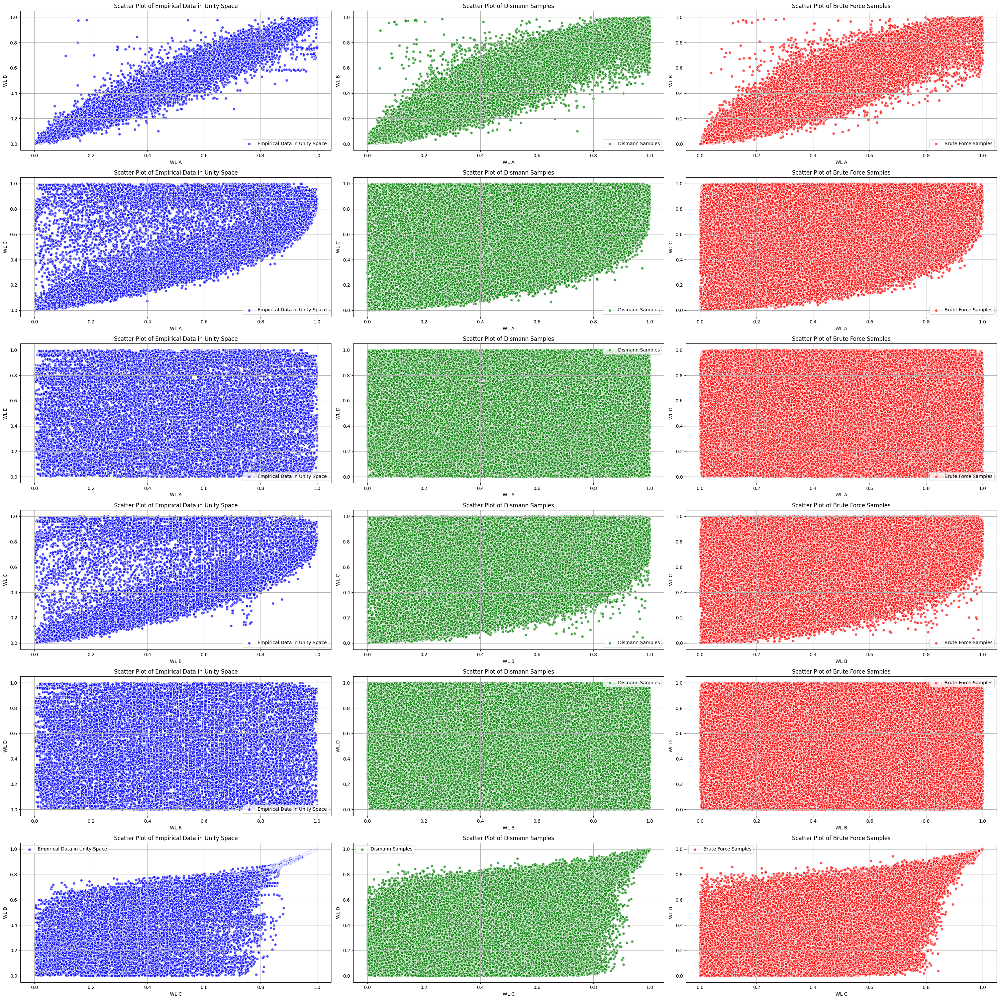

In [21]:
import matplotlib.pyplot as plt

# Define datasets for each plot (A to B, A to C, B to C, A to D, B to D, C to D)
datasets_A_B = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL A', "y_col": 'WL B'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL A', "y_col": 'WL B'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL A', "y_col": 'WL B'}
}

datasets_A_C = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL A', "y_col": 'WL C'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL A', "y_col": 'WL C'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL A', "y_col": 'WL C'}
}

datasets_A_D = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL A', "y_col": 'WL D'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL A', "y_col": 'WL D'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL A', "y_col": 'WL D'}
}

datasets_B_C = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL B', "y_col": 'WL C'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL B', "y_col": 'WL C'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL B', "y_col": 'WL C'}
}

datasets_B_D = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL B', "y_col": 'WL D'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL B', "y_col": 'WL D'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL B', "y_col": 'WL D'}
}

datasets_C_D = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL C', "y_col": 'WL D'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL C', "y_col": 'WL D'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL C', "y_col": 'WL D'}
}

# Create subplots (6 rows, 3 columns)
fig, axes = plt.subplots(6, 3, figsize=(30, 30))

# Plotting A to B in the first row
for ax, (label, info) in zip(axes[0], datasets_A_B.items()):
    data = info["data"]
    color = info["color"]
    x_col = info["x_col"]
    y_col = info["y_col"]
    
    ax.scatter(data[x_col], data[y_col], color=color, edgecolors='white', alpha=0.7, label=label)
    ax.set_xlabel(x_col)
    ax.set_ylabel(y_col)
    ax.set_title(f'Scatter Plot of {label}')
    ax.legend()
    ax.grid(True)

# Plotting A to C in the second row
for ax, (label, info) in zip(axes[1], datasets_A_C.items()):
    data = info["data"]
    color = info["color"]
    x_col = info["x_col"]
    y_col = info["y_col"]
    
    ax.scatter(data[x_col], data[y_col], color=color, edgecolors='white', alpha=0.7, label=label)
    ax.set_xlabel(x_col)
    ax.set_ylabel(y_col)
    ax.set_title(f'Scatter Plot of {label}')
    ax.legend()
    ax.grid(True)

# Plotting A to D in the fourth row
for ax, (label, info) in zip(axes[2], datasets_A_D.items()):
    data = info["data"]
    color = info["color"]
    x_col = info["x_col"]
    y_col = info["y_col"]
    
    ax.scatter(data[x_col], data[y_col], color=color, edgecolors='white', alpha=0.7, label=label)
    ax.set_xlabel(x_col)
    ax.set_ylabel(y_col)
    ax.set_title(f'Scatter Plot of {label}')
    ax.legend()
    ax.grid(True)

# Plotting B to C in the third row
for ax, (label, info) in zip(axes[3], datasets_B_C.items()):
    data = info["data"]
    color = info["color"]
    x_col = info["x_col"]
    y_col = info["y_col"]
    
    ax.scatter(data[x_col], data[y_col], color=color, edgecolors='white', alpha=0.7, label=label)
    ax.set_xlabel(x_col)
    ax.set_ylabel(y_col)
    ax.set_title(f'Scatter Plot of {label}')
    ax.legend()
    ax.grid(True)


# Plotting B to D in the fifth row
for ax, (label, info) in zip(axes[4], datasets_B_D.items()):
    data = info["data"]
    color = info["color"]
    x_col = info["x_col"]
    y_col = info["y_col"]
    
    ax.scatter(data[x_col], data[y_col], color=color, edgecolors='white', alpha=0.7, label=label)
    ax.set_xlabel(x_col)
    ax.set_ylabel(y_col)
    ax.set_title(f'Scatter Plot of {label}')
    ax.legend()
    ax.grid(True)

# Plotting C to D in the sixth row
for ax, (label, info) in zip(axes[5], datasets_C_D.items()):
    data = info["data"]
    color = info["color"]
    x_col = info["x_col"]
    y_col = info["y_col"]
    
    ax.scatter(data[x_col], data[y_col], color=color, edgecolors='white', alpha=0.7, label=label)
    ax.set_xlabel(x_col)
    ax.set_ylabel(y_col)
    ax.set_title(f'Scatter Plot of {label}')
    ax.legend()
    ax.grid(True)

# Adjust layout for better spacing between plots
plt.tight_layout()

# Show the combined figure
plt.savefig("Plot.jpg")
plt.show()


In [22]:
import matplotlib.pyplot as plt

# Define datasets for each plot (A to B, A to C, B to C, A to D, B to D, C to D)
datasets_A_B = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL A', "y_col": 'WL B'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL A', "y_col": 'WL B'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL A', "y_col": 'WL B'}
}

datasets_A_C = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL A', "y_col": 'WL C'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL A', "y_col": 'WL C'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL A', "y_col": 'WL C'}
}

datasets_A_D = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL A', "y_col": 'WL D'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL A', "y_col": 'WL D'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL A', "y_col": 'WL D'}
}

datasets_B_C = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL B', "y_col": 'WL C'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL B', "y_col": 'WL C'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL B', "y_col": 'WL C'}
}

datasets_B_D = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL B', "y_col": 'WL D'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL B', "y_col": 'WL D'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL B', "y_col": 'WL D'}
}

datasets_C_D = {
    "Empirical Data in Unity Space": {"data": unity_data, "color": "blue", "x_col": 'WL C', "y_col": 'WL D'},
    "Dismann Samples": {"data": uvs, "color": "green", "x_col": 'WL C', "y_col": 'WL D'},
    "Brute Force Samples": {"data": samples, "color": "red", "x_col": 'WL C', "y_col": 'WL D'}
}

# Function to plot and save images
def plot_and_save(datasets, filename):
    # Create subplots (1 row, 3 columns)
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Loop through datasets and plot
    for ax, (label, info) in zip(axes, datasets.items()):
        data = info["data"]
        color = info["color"]
        x_col = info["x_col"]
        y_col = info["y_col"]
        
        ax.scatter(data[x_col], data[y_col], color=color, edgecolors='white', alpha=0.7, label=label)
        ax.set_xlabel(x_col)
        ax.set_ylabel(y_col)
        ax.set_title(f'Scatter Plot of {label}')
        ax.legend()
        ax.grid(True)

    # Adjust layout for better spacing between plots
    plt.tight_layout()

    # Save the image
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.close()

# Save each relation's plots separately
plot_and_save(datasets_A_B, "A_to_B_Plots.jpg")
plot_and_save(datasets_A_C, "A_to_C_Plots.jpg")
plot_and_save(datasets_A_D, "A_to_D_Plots.jpg")
plot_and_save(datasets_B_C, "B_to_C_Plots.jpg")
plot_and_save(datasets_B_D, "B_to_D_Plots.jpg")
plot_and_save(datasets_C_D, "C_to_D_Plots.jpg")


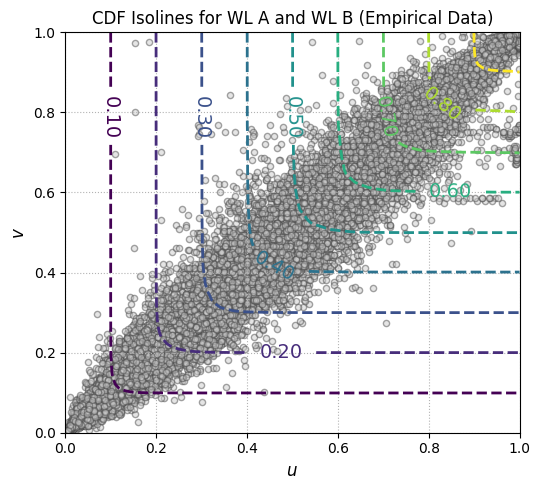

In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assume 'df' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = unity_data["WL A"].values  # You can select the columns you need
data_2 = unity_data["WL B"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)

# Compute the empirical CDF for the selected columns (data_1 and data_2)
cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each pair of data (you can modify this for different pairs)
ax11 = fig.add_subplot(gs[0, 0])

# Scatter plot and CDF isolines for the first pair of variables (WL A and WL B)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=2)
ax11.set_title(r'CDF Isolines for WL A and WL B (Empirical Data)', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)
ax11.set_xlabel(r'$u$', fontsize=12)
ax11.set_ylabel(r'$v$', fontsize=12)
ax11.clabel(contour, fmt='%1.2f', inline=True, fontsize=14)

plt.tight_layout()
plt.show()


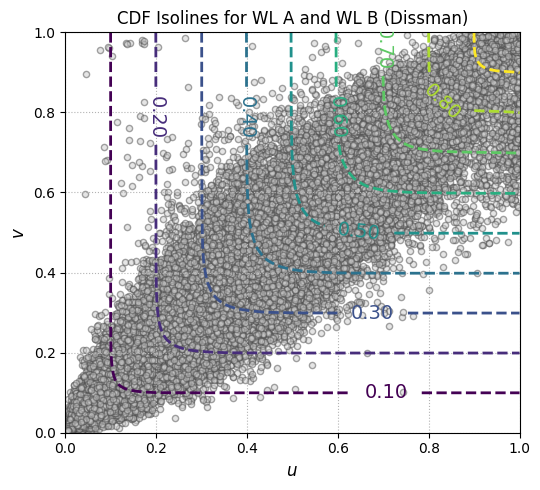

In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assume 'df' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = uvs["WL A"].values  # You can select the columns you need
data_2 = uvs["WL B"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)

# Compute the empirical CDF for the selected columns (data_1 and data_2)
cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each pair of data (you can modify this for different pairs)
ax11 = fig.add_subplot(gs[0, 0])

# Scatter plot and CDF isolines for the first pair of variables (WL A and WL B)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=2)
ax11.set_title(r'CDF Isolines for WL A and WL B (Dissman)', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)
ax11.set_xlabel(r'$u$', fontsize=12)
ax11.set_ylabel(r'$v$', fontsize=12)
ax11.clabel(contour, fmt='%1.2f', inline=True, fontsize=14)

plt.tight_layout()
plt.show()


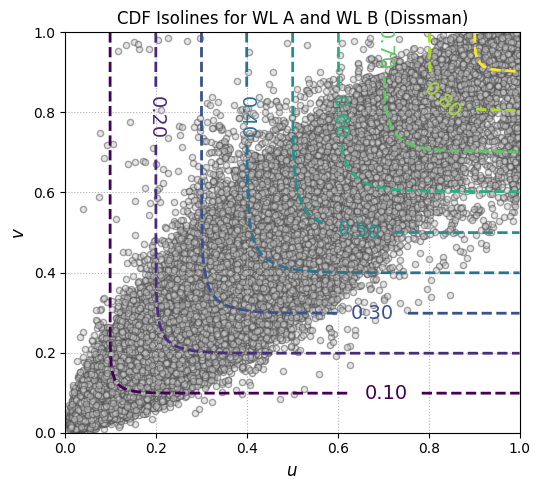

In [25]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assume 'df' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = samples["WL A"].values  # You can select the columns you need
data_2 = samples["WL B"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)

# Compute the empirical CDF for the selected columns (data_1 and data_2)
cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each pair of data (you can modify this for different pairs)
ax11 = fig.add_subplot(gs[0, 0])

# Scatter plot and CDF isolines for the first pair of variables (WL A and WL B)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=2)
ax11.set_title(r'CDF Isolines for WL A and WL B (Dissman)', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)
ax11.set_xlabel(r'$u$', fontsize=12)
ax11.set_ylabel(r'$v$', fontsize=12)
ax11.clabel(contour, fmt='%1.2f', inline=True, fontsize=14)

plt.tight_layout()
plt.show()


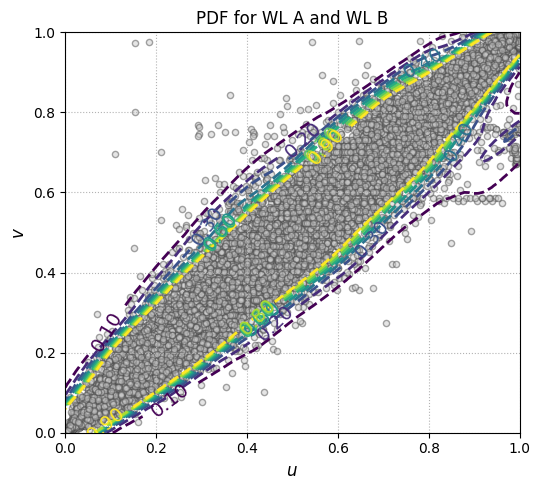

In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from scipy.stats import gaussian_kde

# Assume 'df' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = unity_data["WL A"].values  # You can select the columns you need
data_2 = unity_data["WL B"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical PDF using KDE
def empirical_pdf(data, grid_points):
    kde = gaussian_kde(data.T)  # Transpose so each row corresponds to one variable
    pdf_values = kde(grid_points.T)  # Evaluate the KDE on the grid
    return pdf_values.reshape(XX.shape)

# Compute the empirical PDF for the selected columns (data_1 and data_2)
pdf_grid = empirical_pdf(np.column_stack([data_1, data_2]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each pair of data (you can modify this for different pairs)
ax11 = fig.add_subplot(gs[0, 0])

# Scatter plot and PDF isolines for the first pair of variables (WL A and WL B)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour = ax11.contour(XX, YY, pdf_grid, levels=contour_levels, linestyles='dashed', linewidths=2)
ax11.set_title(r'PDF for WL A and WL B', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)
ax11.set_xlabel(r'$u$', fontsize=12)
ax11.set_ylabel(r'$v$', fontsize=12)
ax11.clabel(contour, fmt='%1.2f', inline=True, fontsize=14)

plt.tight_layout()
plt.show()



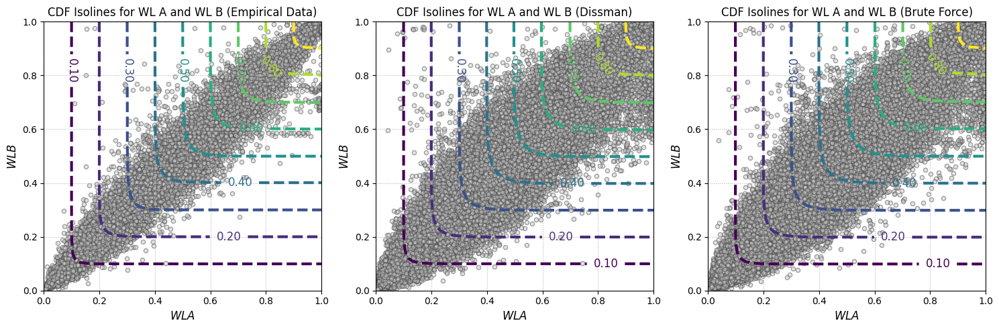

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assume 'samples' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = unity_data["WL A"].values  # You can select the columns you need
data_2 = unity_data["WL B"].values

# Extract relevant columns from df
data_3 = uvs["WL A"].values  # You can select the columns you need
data_4 = uvs["WL B"].values

# Extract relevant columns from df
data_5 = samples["WL A"].values  # You can select the columns you need
data_6 = samples["WL B"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)

# Compute the empirical CDF for the selected columns (data_1 and data_2)
cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)
cdf_grid2 = empirical_cdf(np.column_stack([data_3, data_4]), XX_YY)
cdf_grid3 = empirical_cdf(np.column_stack([data_5, data_6]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout for subplots
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each plot
ax11 = fig.add_subplot(gs[0, 0])
ax12 = fig.add_subplot(gs[0, 1])
ax13 = fig.add_subplot(gs[0, 2])

# Scatter and contour for the first subplot (using data_1 and data_2)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour1 = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=3)
ax11.clabel(contour1, fmt='%1.2f', inline=True, fontsize=12)
ax11.set_title(r'CDF Isolines for WL A and WL B (Empirical Data)', fontsize=12)
ax11.set_xlabel(r'$WL A$', fontsize=12)
ax11.set_ylabel(r'$WL B$', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the second subplot (using data_1 and data_2, or another pair if needed)
ax12.scatter(data_3, data_4, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour2 = ax12.contour(XX, YY, cdf_grid2, levels=contour_levels, linestyles='dashed', linewidths=3)
ax12.clabel(contour2, fmt='%1.2f', inline=True, fontsize=12)
ax12.set_title(r'CDF Isolines for WL A and WL B (Dissman)', fontsize=12)
ax12.set_xlabel(r'$WL A$', fontsize=12)
ax12.set_ylabel(r'$WL B$', fontsize=12)
ax12.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the third subplot (using data_1 and data_2, or another pair if needed)
ax13.scatter(data_5, data_6, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour3 = ax13.contour(XX, YY, cdf_grid3, levels=contour_levels, linestyles='dashed',linewidths=3, cmap='viridis')
ax13.clabel(contour3, fmt='%1.2f', inline=True, fontsize=12)
ax13.set_title(r'CDF Isolines for WL A and WL B (Brute Force)', fontsize=12)
ax13.set_xlabel(r'$WL A$', fontsize=12)
ax13.set_ylabel(r'$WL B$', fontsize=12)
ax13.grid(color='.7', linestyle='dotted', zorder=-1)

# Adjust layout to avoid overlapping
plt.tight_layout()

# Display the plot
plt.savefig("CDF Isolines WL A B.jpg")
plt.show()


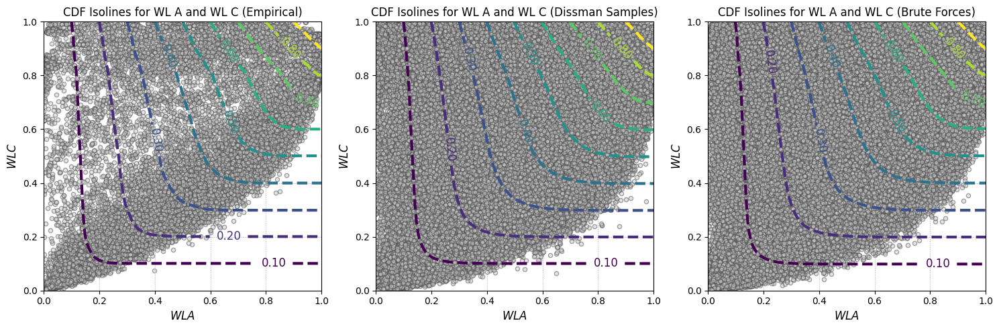

In [28]:

# Assume 'samples' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = unity_data["WL A"].values  # You can select the columns you need
data_2 = unity_data["WL C"].values

# Extract relevant columns from df
data_3 = uvs["WL A"].values  # You can select the columns you need
data_4 = uvs["WL C"].values

# Extract relevant columns from df
data_5 = samples["WL A"].values  # You can select the columns you need
data_6 = samples["WL C"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)


cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)
cdf_grid2 = empirical_cdf(np.column_stack([data_3, data_4]), XX_YY)
cdf_grid3 = empirical_cdf(np.column_stack([data_5, data_6]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout for subplots
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each plot
ax11 = fig.add_subplot(gs[0, 0])
ax12 = fig.add_subplot(gs[0, 1])
ax13 = fig.add_subplot(gs[0, 2])

# Scatter and contour for the first subplot (using data_1 and data_2)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour1 = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=3)
ax11.clabel(contour1, fmt='%1.2f', inline=True, fontsize=12)
ax11.set_title(r'CDF Isolines for WL A and WL C (Empirical)', fontsize=12)
ax11.set_xlabel(r'$WL A$', fontsize=12)
ax11.set_ylabel(r'$WL C$', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the second subplot (using data_1 and data_2, or another pair if needed)
ax12.scatter(data_3, data_4, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour2 = ax12.contour(XX, YY, cdf_grid2, levels=contour_levels, linestyles='dashed', linewidths=3)
ax12.clabel(contour2, fmt='%1.2f', inline=True, fontsize=12)
ax12.set_title(r'CDF Isolines for WL A and WL C (Dissman Samples)', fontsize=12)
ax12.set_xlabel(r'$WL A$', fontsize=12)
ax12.set_ylabel(r'$WL C$', fontsize=12)
ax12.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the third subplot (using data_1 and data_2, or another pair if needed)
ax13.scatter(data_5, data_6, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour3 = ax13.contour(XX, YY, cdf_grid3, levels=contour_levels, linestyles='dashed',linewidths=3, cmap='viridis')
ax13.clabel(contour3, fmt='%1.2f', inline=True, fontsize=12)
ax13.set_title(r'CDF Isolines for WL A and WL C (Brute Forces)', fontsize=12)
ax13.set_xlabel(r'$WL A$', fontsize=12)
ax13.set_ylabel(r'$WL C$', fontsize=12)
ax13.grid(color='.7', linestyle='dotted', zorder=-1)

# Adjust layout to avoid overlapping
plt.tight_layout()
plt.savefig("CDF Isolines WL A C.jpg")
# Display the plot
plt.show()


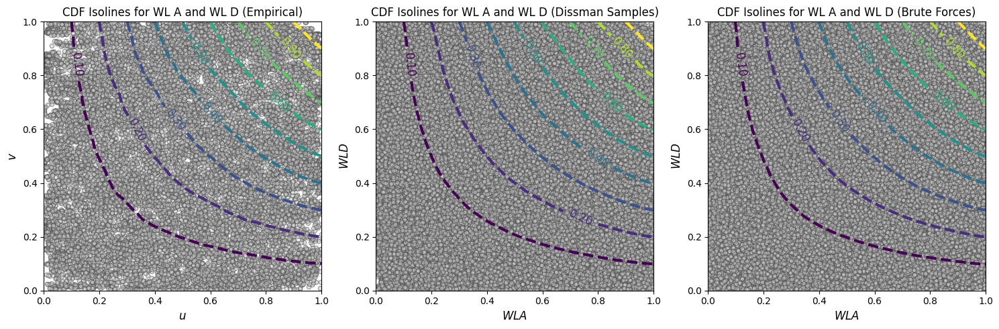

In [29]:

# Assume 'samples' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = unity_data["WL A"].values  # You can select the columns you need
data_2 = unity_data["WL D"].values

# Extract relevant columns from df
data_3 = uvs["WL A"].values  # You can select the columns you need
data_4 = uvs["WL D"].values

# Extract relevant columns from df
data_5 = samples["WL A"].values  # You can select the columns you need
data_6 = samples["WL D"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)

# Compute the empirical CDF for the selected columns (data_1 and data_2)
cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)
cdf_grid2 = empirical_cdf(np.column_stack([data_3, data_4]), XX_YY)
cdf_grid3 = empirical_cdf(np.column_stack([data_5, data_6]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout for subplots
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each plot
ax11 = fig.add_subplot(gs[0, 0])
ax12 = fig.add_subplot(gs[0, 1])
ax13 = fig.add_subplot(gs[0, 2])

# Scatter and contour for the first subplot (using data_1 and data_2)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour1 = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=3)
ax11.clabel(contour1, fmt='%1.2f', inline=True, fontsize=12)
ax11.set_title(r'CDF Isolines for WL A and WL D (Empirical)', fontsize=12)
ax11.set_xlabel(r'$u$', fontsize=12)
ax11.set_ylabel(r'$v$', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the second subplot (using data_1 and data_2, or another pair if needed)
ax12.scatter(data_3, data_4, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour2 = ax12.contour(XX, YY, cdf_grid2, levels=contour_levels, linestyles='dashed', linewidths=3)
ax12.clabel(contour2, fmt='%1.2f', inline=True, fontsize=12)
ax12.set_title(r'CDF Isolines for WL A and WL D (Dissman Samples)', fontsize=12)
ax12.set_xlabel(r'$WL A$', fontsize=12)
ax12.set_ylabel(r'$WL D$', fontsize=12)
ax12.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the third subplot (using data_1 and data_2, or another pair if needed)
ax13.scatter(data_5, data_6, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour3 = ax13.contour(XX, YY, cdf_grid3, levels=contour_levels, linestyles='dashed',linewidths=3, cmap='viridis')
ax13.clabel(contour3, fmt='%1.2f', inline=True, fontsize=12)
ax13.set_title(r'CDF Isolines for WL A and WL D (Brute Forces)', fontsize=12)
ax13.set_xlabel(r'$WL A$', fontsize=12)
ax13.set_ylabel(r'$WL D$', fontsize=12)
ax13.grid(color='.7', linestyle='dotted', zorder=-1)

# Adjust layout to avoid overlapping
plt.tight_layout()

# Display the plot
plt.savefig("CDF Isolines WL A D.jpg")
plt.show()


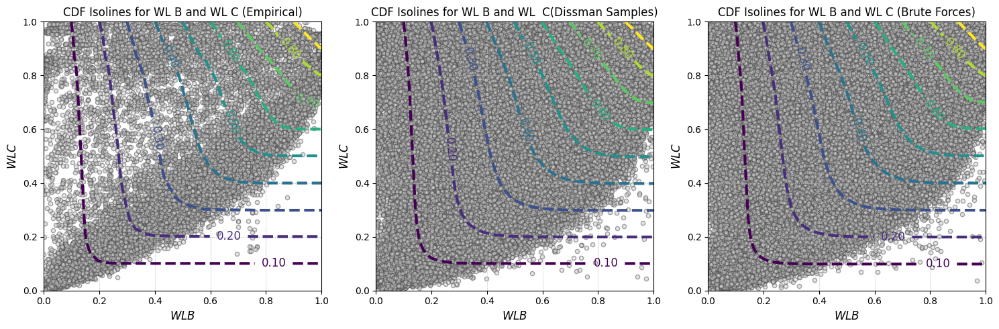

In [31]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assume 'samples' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = unity_data["WL B"].values  # You can select the columns you need
data_2 = unity_data["WL C"].values

# Extract relevant columns from df
data_3 = uvs["WL B"].values  # You can select the columns you need
data_4 = uvs["WL C"].values

# Extract relevant columns from df
data_5 = samples["WL B"].values  # You can select the columns you need
data_6 = samples["WL C"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)

# Compute the empirical CDF for the selected columns (data_1 and data_2)
cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)
cdf_grid2 = empirical_cdf(np.column_stack([data_3, data_4]), XX_YY)
cdf_grid3 = empirical_cdf(np.column_stack([data_5, data_6]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout for subplots
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each plot
ax11 = fig.add_subplot(gs[0, 0])
ax12 = fig.add_subplot(gs[0, 1])
ax13 = fig.add_subplot(gs[0, 2])

# Scatter and contour for the first subplot (using data_1 and data_2)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour1 = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=3)
ax11.clabel(contour1, fmt='%1.2f', inline=True, fontsize=12)
ax11.set_title(r'CDF Isolines for WL B and WL C (Empirical)', fontsize=12)
ax11.set_xlabel(r'$WL B$', fontsize=12)
ax11.set_ylabel(r'$WL C$', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the second subplot (using data_1 and data_2, or another pair if needed)
ax12.scatter(data_3, data_4, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour2 = ax12.contour(XX, YY, cdf_grid2, levels=contour_levels, linestyles='dashed', linewidths=3)
ax12.clabel(contour2, fmt='%1.2f', inline=True, fontsize=12)
ax12.set_title(r'CDF Isolines for WL B and WL  C(Dissman Samples)', fontsize=12)
ax12.set_xlabel(r'$WL B$', fontsize=12)
ax12.set_ylabel(r'$WL C$', fontsize=12)
ax12.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the third subplot (using data_1 and data_2, or another pair if needed)
ax13.scatter(data_5, data_6, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour3 = ax13.contour(XX, YY, cdf_grid3, levels=contour_levels, linestyles='dashed',linewidths=3, cmap='viridis')
ax13.clabel(contour3, fmt='%1.2f', inline=True, fontsize=12)
ax13.set_title(r'CDF Isolines for WL B and WL C (Brute Forces)', fontsize=12)
ax13.set_xlabel(r'$WL B$', fontsize=12)
ax13.set_ylabel(r'$WL C$', fontsize=12)
ax13.grid(color='.7', linestyle='dotted', zorder=-1)

# Adjust layout to avoid overlapping
plt.tight_layout()

# Display the plot
plt.savefig("CDF Isolines for WL B and C.jpg")
plt.show()


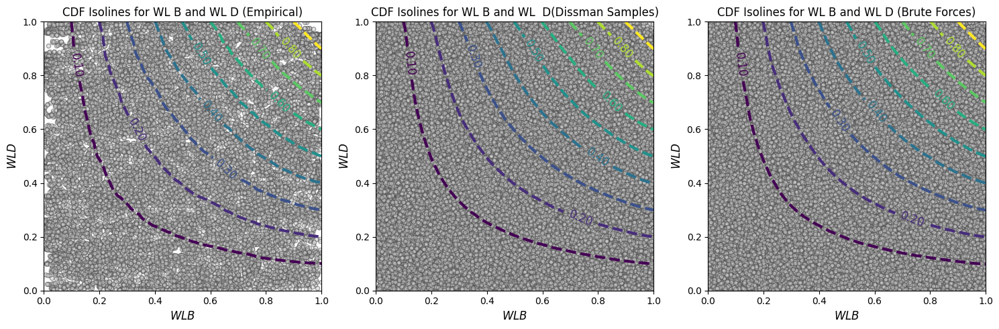

In [32]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assume 'samples' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = unity_data["WL B"].values  # You can select the columns you need
data_2 = unity_data["WL D"].values

# Extract relevant columns from df
data_3 = uvs["WL B"].values  # You can select the columns you need
data_4 = uvs["WL D"].values

# Extract relevant columns from df
data_5 = samples["WL B"].values  # You can select the columns you need
data_6 = samples["WL D"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)


cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)
cdf_grid2 = empirical_cdf(np.column_stack([data_3, data_4]), XX_YY)
cdf_grid3 = empirical_cdf(np.column_stack([data_5, data_6]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout for subplots
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each plot
ax11 = fig.add_subplot(gs[0, 0])
ax12 = fig.add_subplot(gs[0, 1])
ax13 = fig.add_subplot(gs[0, 2])

# Scatter and contour for the first subplot (using data_1 and data_2)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour1 = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=3)
ax11.clabel(contour1, fmt='%1.2f', inline=True, fontsize=12)
ax11.set_title(r'CDF Isolines for WL B and WL D (Empirical)', fontsize=12)
ax11.set_xlabel(r'$WL B$', fontsize=12)
ax11.set_ylabel(r'$WL D$', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the second subplot (using data_1 and data_2, or another pair if needed)
ax12.scatter(data_3, data_4, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour2 = ax12.contour(XX, YY, cdf_grid2, levels=contour_levels, linestyles='dashed', linewidths=3)
ax12.clabel(contour2, fmt='%1.2f', inline=True, fontsize=12)
ax12.set_title(r'CDF Isolines for WL B and WL  D(Dissman Samples)', fontsize=12)
ax12.set_xlabel(r'$WL B$', fontsize=12)
ax12.set_ylabel(r'$WL D$', fontsize=12)
ax12.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the third subplot (using data_1 and data_2, or another pair if needed)
ax13.scatter(data_5, data_6, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour3 = ax13.contour(XX, YY, cdf_grid3, levels=contour_levels, linestyles='dashed',linewidths=3, cmap='viridis')
ax13.clabel(contour3, fmt='%1.2f', inline=True, fontsize=12)
ax13.set_title(r'CDF Isolines for WL B and WL D (Brute Forces)', fontsize=12)
ax13.set_xlabel(r'$WL B$', fontsize=12)
ax13.set_ylabel(r'$WL D$', fontsize=12)
ax13.grid(color='.7', linestyle='dotted', zorder=-1)

# Adjust layout to avoid overlapping
plt.tight_layout()
plt.savefig("CDF Isolines WL B D.jpg")
# Display the plot
plt.show()


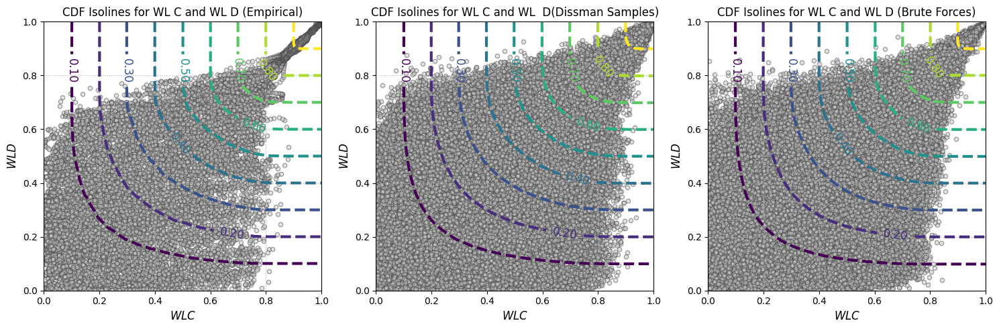

In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Assume 'samples' is the DataFrame with unity space data
# Example: df = pd.read_csv("your_data.csv")

# Extract relevant columns from df
data_1 = unity_data["WL C"].values  # You can select the columns you need
data_2 = unity_data["WL D"].values

# Extract relevant columns from df
data_3 = uvs["WL C"].values  # You can select the columns you need
data_4 = uvs["WL D"].values

# Extract relevant columns from df
data_5 = samples["WL C"].values  # You can select the columns you need
data_6 = samples["WL D"].values

# Define grid for plotting
X = np.linspace(0, 1, 100)
Y = np.linspace(0, 1, 100)
XX, YY = np.meshgrid(X, Y)
XX_YY = np.column_stack([XX.ravel(), YY.ravel()])

# Function to compute the empirical CDF
def empirical_cdf(data, grid_points):
    cdf_values = np.array([
        np.mean(np.all(data <= [x, y], axis=1)) for x, y in grid_points
    ])
    return cdf_values.reshape(XX.shape)

# Compute the empirical CDF for the selected columns (data_1 and data_2)
cdf_grid = empirical_cdf(np.column_stack([data_1, data_2]), XX_YY)
cdf_grid2 = empirical_cdf(np.column_stack([data_3, data_4]), XX_YY)
cdf_grid3 = empirical_cdf(np.column_stack([data_5, data_6]), XX_YY)

# Define contour levels
contour_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

# Create the figure and gridspec layout for subplots
fig = plt.figure(figsize=(15, 5))
gs = gridspec.GridSpec(ncols=3, nrows=1, figure=fig)

# Create subplots for each plot
ax11 = fig.add_subplot(gs[0, 0])
ax12 = fig.add_subplot(gs[0, 1])
ax13 = fig.add_subplot(gs[0, 2])

# Scatter and contour for the first subplot (using data_1 and data_2)
ax11.scatter(data_1, data_2, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour1 = ax11.contour(XX, YY, cdf_grid, levels=contour_levels, linestyles='dashed', linewidths=3)
ax11.clabel(contour1, fmt='%1.2f', inline=True, fontsize=12)
ax11.set_title(r'CDF Isolines for WL C and WL D (Empirical)', fontsize=12)
ax11.set_xlabel(r'$WL C$', fontsize=12)
ax11.set_ylabel(r'$WL D$', fontsize=12)
ax11.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the second subplot (using data_1 and data_2, or another pair if needed)
ax12.scatter(data_3, data_4, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour2 = ax12.contour(XX, YY, cdf_grid2, levels=contour_levels, linestyles='dashed', linewidths=3)
ax12.clabel(contour2, fmt='%1.2f', inline=True, fontsize=12)
ax12.set_title(r'CDF Isolines for WL C and WL  D(Dissman Samples)', fontsize=12)
ax12.set_xlabel(r'$WL C$', fontsize=12)
ax12.set_ylabel(r'$WL D$', fontsize=12)
ax12.grid(color='.7', linestyle='dotted', zorder=-1)

# Scatter and contour for the third subplot (using data_1 and data_2, or another pair if needed)
ax13.scatter(data_5, data_6, s=20, alpha=0.5, marker="o", c='0.8', edgecolor='0.3')
contour3 = ax13.contour(XX, YY, cdf_grid3, levels=contour_levels, linestyles='dashed',linewidths=3, cmap='viridis')
ax13.clabel(contour3, fmt='%1.2f', inline=True, fontsize=12)
ax13.set_title(r'CDF Isolines for WL C and WL D (Brute Forces)', fontsize=12)
ax13.set_xlabel(r'$WL C$', fontsize=12)
ax13.set_ylabel(r'$WL D$', fontsize=12)
ax13.grid(color='.7', linestyle='dotted', zorder=-1)

# Adjust layout to avoid overlapping
plt.tight_layout()
plt.savefig("CDF Isolines WL C D.jpg")
# Display the plot
plt.show()
